<div class="alert alert-block alert-success">

# **1.** Environment Setup

<div>

## 1.1 Import Libraries

In [1]:
import pandas as pd
import zipfile
import pickle
from sklearn.preprocessing import LabelEncoder
from pathlib import Path
from sklearn.model_selection import train_test_split
from tensorflow import keras
from keras import regularizers
from classes import *
from functions import *

/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import tensorflow as tf
from tensorflow.keras import models
from tensorflow.keras import layers
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Concatenate, Dropout, Input, Conv2D, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ReduceLROnPlateau
from keras.metrics import AUC, F1Score, CategoricalAccuracy, TopKCategoricalAccuracy
from sklearn.metrics import f1_score, precision_score, recall_score
from keras import optimizers

## 1.2 Import Dataset

The amount of data we have is not supported by GitHub (where we have our project stored). The solution is: create a folder named data and allocate the rare_species file inside it. The gitignore file makes sure this folder is not used when we are pulling or pushing changes but everyone needs to have it on their machines locally. A random seed was used to ensure that the splits stay the same.

In [3]:
# Import Metadata
metadata_path = Path("../data/rare_species/metadata.csv")
df = pd.read_csv(metadata_path)
df.head()

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...
3,29cc6040-6af2-49ee-86ec-ab7d89793828,29658536,45510188,animalia,chordata,turdidae,chordata_turdidae/29658536_45510188_eol-full-s...
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...


In [4]:
df.shape # 11983 images

(11983, 7)

<div class="alert alert-block alert-success">

# **2.** Preprocessing

<div>

In [5]:
#Load the DataFrames from the .pkl files
with open("../data/train_df.pkl", "rb") as f:
     train_df = pickle.load(f)

with open("../data/valid_df.pkl", "rb") as f:
     val_df = pickle.load(f)

with open("../data/test_df.pkl", "rb") as f:
     test_df = pickle.load(f)

with open("family_encoder.pkl", "rb") as f:
     family_encoder = pickle.load(f)

with open("phylum_encoder.pkl", "rb") as f:
     phylum_encoder = pickle.load(f)

In [6]:
# identify the minority class
minority_class = train_df['family'].value_counts()[train_df['family'].value_counts() < 25].index
minority_class = minority_class.to_list()

In [7]:
batch_size = 32 ## the less the better because in each epoch the model sees N / batch_size images
image_size = (224, 224)

preprocess = Preprocessor(image_size=image_size, batch_size=batch_size)

In [8]:
# num_images = 16 ##
# rows, cols = 4, 4 ##

# plot_batch(train_ds, class_names=class_names, num_images=num_images, rows=rows, cols=cols)

<div class="alert alert-block alert-success">

# **3.** Results Analysis

<div>

In [9]:
# Load model keras
model = load_model("efficient_net_finetuned_final.keras")

/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/keras/src/saving/saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'rmsprop', because it has 34 variables whereas the saved optimizer has 6 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


In [10]:
# load datasets
train_ds, class_names = preprocess.load_img(
    data_dir="../data/rare_species/train",
    minority_class=minority_class,
    augment='mixup',
    oversampling=True,
    shuffle=True,
    preprocessing_function=preprocess_input)

# val_ds, _ = preprocess.load_img(
#     data_dir="../data/rare_species/val",
#     minority_class=[],
#     augment=None,
#     shuffle= False,
#     preprocessing_function=preprocess_input)

test_ds, _ = preprocess.load_img(
    data_dir="../data/rare_species/test",
    minority_class=[],
    augment=None,
    shuffle= False,
    preprocessing_function=preprocess_input)

Found 8388 files belonging to 202 classes.
Found 1798 files belonging to 202 classes.


In [11]:
# Load encoder
import pickle

with open('family_encoder.pkl', 'rb') as f:
    family_encoder = pickle.load(f)

# Load class names
class_names = family_encoder.classes_

class_names

array(['accipitridae', 'acipenseridae', 'acroporidae', 'agamidae',
       'agariciidae', 'albulidae', 'alcedinidae', 'alligatoridae',
       'alopiidae', 'ambystomatidae', 'anatidae', 'anguidae', 'aotidae',
       'apidae', 'ardeidae', 'arthroleptidae', 'atelidae', 'attelabidae',
       'balaenicipitidae', 'balaenidae', 'balaenopteridae', 'balistidae',
       'bombycillidae', 'bovidae', 'brachypteraciidae', 'bucerotidae',
       'bufonidae', 'burhinidae', 'cacatuidae', 'callitrichidae',
       'callorhinchidae', 'caprimulgidae', 'carabidae', 'carcharhinidae',
       'cardiidae', 'carettochelyidae', 'cebidae', 'cerambycidae',
       'cercopithecidae', 'cervidae', 'cetorhinidae', 'chaetodontidae',
       'chamaeleonidae', 'charadriidae', 'cheirogaleidae', 'chelidae',
       'cheloniidae', 'chelydridae', 'ciconiidae', 'coenagrionidae',
       'colubridae', 'columbidae', 'conidae', 'cracidae', 'cricetidae',
       'crocodylidae', 'cryptobranchidae', 'ctenomyidae', 'cuculidae',
       'cypr

### Classification report

In [12]:
y_true, y_pred = get_metric(test_ds, "efficient_net_finetuned_final.keras")


Evaluating model: efficient_net_finetuned_final.keras
              precision    recall  f1-score   support

           0     0.7143    0.8333    0.7692        18
           1     0.7000    0.5000    0.5833        14
           2     0.6000    0.9375    0.7317        32
           3     0.8000    0.4444    0.5714         9
           4     0.3438    0.6111    0.4400        18
           5     0.2500    0.2500    0.2500         4
           6     1.0000    0.6000    0.7500         5
           7     1.0000    0.2500    0.4000         4
           8     0.0000    0.0000    0.0000         9
           9     1.0000    0.1111    0.2000         9
          10     0.5227    0.8519    0.6479        27
          11     0.6667    0.6667    0.6667         9
          12     1.0000    0.4444    0.6154         9
          13     1.0000    0.9565    0.9778        23
          14     0.6667    0.8889    0.7619         9
          15     1.0000    0.2000    0.3333         5
          16     0.6364   

2025-04-27 20:51:48.339979: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(re

### Confusion matrix

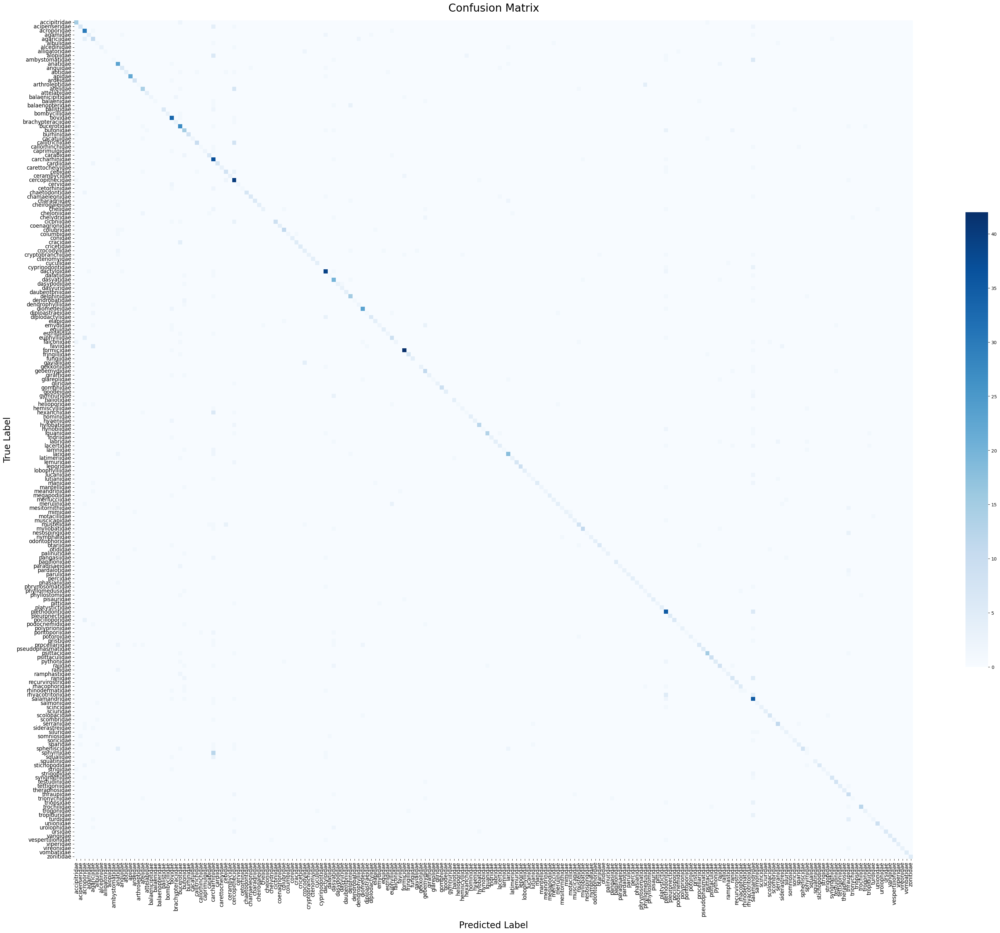

In [13]:
# Example usage with y_true, y_pred, and class_names
plot_confusion_matrix(y_true, y_pred, class_names, figsize=(35, 30), fontsize=12, title="Confusion Matrix")

### F1-Score and Support per Class

In [14]:
# Confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Classification report for precision, recall, f1
report = classification_report(y_true, y_pred, target_names=class_names, output_dict=True)

# Extract per-class F1-scores and supports
class_f1 = {}
supports = {}

for cls in class_names:
    f1 = report[cls]['f1-score']
    support = report[cls]['support']
    class_f1[cls] = f1
    supports[cls] = support

# Sort classes by F1-score
asc_sorted_classes = sorted(class_f1.items(), key=lambda x: x[1])  # ascending
dsc_sorted_classes = sorted(class_f1.items(), key=lambda x: x[1], reverse=True)  # descending

/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/Users/mgalao/Library/CloudStorage/OneDrive-NOVAIMS/MSc_DSAA-DS/2nd Semester/Q3 Deep Learning/deep-learning-project/venv/lib/python3.11/site-packa

In [15]:
top_n = 10

# Best classified classes
best_classes = {
    'Class': [],
    'F1-Score': [],
    'Support': []
}

for cls, f1 in dsc_sorted_classes[:top_n]:
    best_classes['Class'].append(cls)
    best_classes['F1-Score'].append(round(f1, 4))
    best_classes['Support'].append(round(supports[cls], 4))

best_df = pd.DataFrame(best_classes)

# Worst classified classes
worst_classes = {
    'Class': [],
    'F1-Score': [],
    'Support': []
}

for cls, f1 in asc_sorted_classes[:top_n]:
    worst_classes['Class'].append(cls)
    worst_classes['F1-Score'].append(round(f1, 4))
    worst_classes['Support'].append(round(supports[cls], 4))

worst_df = pd.DataFrame(worst_classes)

# Display them
print("\nBest Classified Classes:")
display(best_df)

print("\nWorst Classified Classes:")
display(worst_df)


Best Classified Classes:


,Class,F1-Score,Support
0,coenagrionidae,1.0,4.0
1,conidae,1.0,4.0
2,cricetidae,1.0,5.0
3,ctenomyidae,1.0,4.0
4,daubentoniidae,1.0,4.0
5,fungiidae,1.0,4.0
6,gomphidae,1.0,9.0
7,hominidae,1.0,4.0
8,leporidae,1.0,9.0
9,lobophylliidae,1.0,4.0



Worst Classified Classes:


,Class,F1-Score,Support
0,alopiidae,0.0,9.0
1,balaenopteridae,0.0,5.0
2,cheloniidae,0.0,4.0
3,chelydridae,0.0,4.0
4,cyprinodontidae,0.0,4.0
5,faviidae,0.0,9.0
6,gavialidae,0.0,4.0
7,gymnuridae,0.0,5.0
8,pangasiidae,0.0,5.0
9,rhyacotritonidae,0.0,9.0


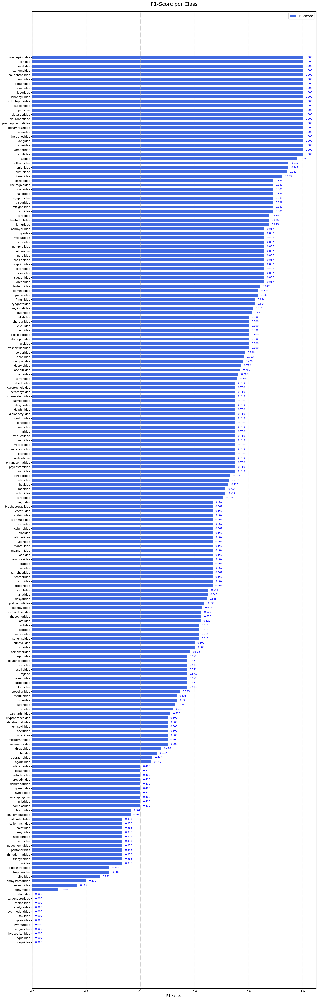

In [54]:
# Prepare data sorted descending by F1
classes = [cls for cls, _ in dsc_sorted_classes]
f1_scores = [round(class_f1[cls], 4) for cls in classes]

# Settings
fig, ax = plt.subplots(figsize=(16, 50))  # Big figure to fit all classes

y_pos = np.arange(len(classes)) * 1.5  # Space between bars
bar_width = 1.0  # Wider bars

# Plot F1 bars
f1_bars = ax.barh(y_pos, f1_scores, height=bar_width, color='royalblue', label='F1-score')

# Labels
ax.set_yticks(y_pos)
ax.set_yticklabels(classes, fontsize=10)  # Bigger class labels
ax.invert_yaxis()  # Best F1 on top
ax.set_xlabel('F1-score', fontsize=14)
ax.set_xlim(0, 1.05)
ax.set_title('F1-Score per Class', fontsize=18, pad=20)
ax.legend(fontsize=12)

# Grid
plt.grid(axis='x', linestyle='--', alpha=0.6)

# Add value labels to bars
for bar in f1_bars:
    width = bar.get_width()
    ax.text(width + 0.01, bar.get_y() + bar.get_height()/2, f'{width:.3f}', 
            va='center', ha='left', fontsize=9, color='blue')

# Adjust layout
plt.subplots_adjust(top=0.98, bottom=0.02)
plt.tight_layout()
plt.show()

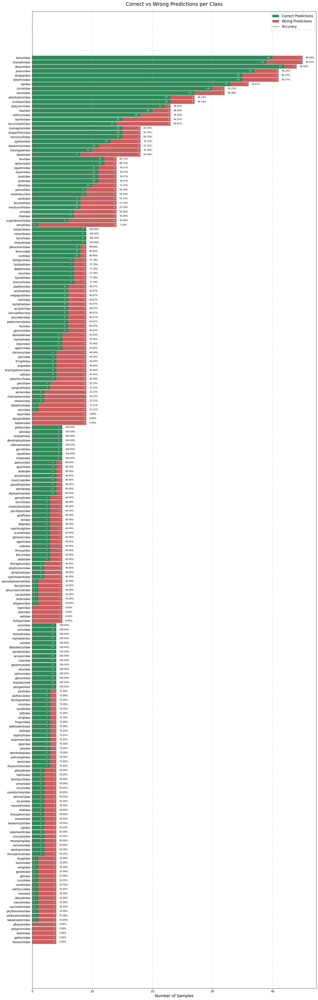

In [49]:
import numpy as np
import matplotlib.pyplot as plt

# Calculate correct and wrong per class
correct_counts = []
wrong_counts = []
total_counts = []
accuracies = []  # To store accuracies

for i, cls in enumerate(classes):
    correct = cm[i, i]  # True Positives for class i
    total = cm[i].sum()  # Total actual samples of class i
    wrong = total - correct
    accuracy = correct / total * 100 if total > 0 else 0  # Avoid division by zero
    correct_counts.append(correct)
    wrong_counts.append(wrong)
    total_counts.append(total)
    accuracies.append(accuracy)

# Sort classes
sorted_classes = sorted(
    zip(classes, correct_counts, wrong_counts, total_counts, accuracies),
    key=lambda x: (x[3], x[1]),  # Sort by total then correct
    reverse=True
)

# Unzip sorted
classes_sorted, correct_counts_sorted, wrong_counts_sorted, total_counts_sorted, accuracies_sorted = zip(*sorted_classes)

# Settings
fig, ax = plt.subplots(figsize=(16, 50))  # Tall for many classes
y_pos = np.arange(len(classes_sorted))
bar_width = 0.9

# Bars
correct_bars = ax.barh(y_pos, correct_counts_sorted, height=bar_width, color='seagreen', label='Correct Predictions')
wrong_bars = ax.barh(y_pos, wrong_counts_sorted, left=correct_counts_sorted, height=bar_width, color='indianred', label='Wrong Predictions')

# Labels
ax.set_yticks(y_pos)
ax.set_yticklabels(classes_sorted, fontsize=10)
ax.invert_yaxis()
ax.set_xlabel('Number of Samples', fontsize=14)
ax.set_title('Correct vs Wrong Predictions per Class', fontsize=18, pad=20)

# Value labels
fixed_spacing = 0.5
for bar1, bar2, accuracy in zip(correct_bars, wrong_bars, accuracies_sorted):
    width1 = bar1.get_width()
    width2 = bar2.get_width()
    if width1 > 0:
        ax.text(width1 - fixed_spacing, bar1.get_y() + bar1.get_height()/2, int(width1), va='center', ha='right', fontsize=8, color='white')
    if width2 > 0:
        ax.text(width1 + width2 - fixed_spacing, bar2.get_y() + bar2.get_height()/2, int(width2), va='center', ha='left', fontsize=8, color='white')
    ax.text(width1 + width2 + fixed_spacing, bar1.get_y() + bar1.get_height()/2, f"{accuracy:.2f}%", va='center', ha='left', fontsize=8, color='black')

# Grid
ax.grid(axis='x', linestyle='--', alpha=0.5)

# Legend
handles, labels = ax.get_legend_handles_labels()
accuracy_patch = plt.Line2D([0], [0], color='gray', lw=2, label='Accuracy')
handles.append(accuracy_patch)
labels.append('Accuracy')
ax.legend(handles=handles, labels=labels, fontsize=12)

# Layout
plt.subplots_adjust(top=0.98, bottom=0.02)
plt.tight_layout()
plt.show()

### Visualize high confidence images

In [18]:
# Unbatch test_ds into list
test_images = []
test_labels = []

for img, label in test_ds.unbatch():
    test_images.append(img.numpy())
    test_labels.append(label.numpy())

test_images = np.array(test_images)
test_labels = np.array(test_labels)

# Predict all test images
pred_probs_all = model.predict(test_images, verbose=1)
y_pred = np.argmax(pred_probs_all, axis=1)
y_true = test_labels

2025-04-27 20:52:13.810450: I tensorflow/core/framework/local_rendezvous.cc:405] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


57/57 ━━━━━━━━━━━━━━━━━━━━ 90s 1s/step


#### Top Missclassified

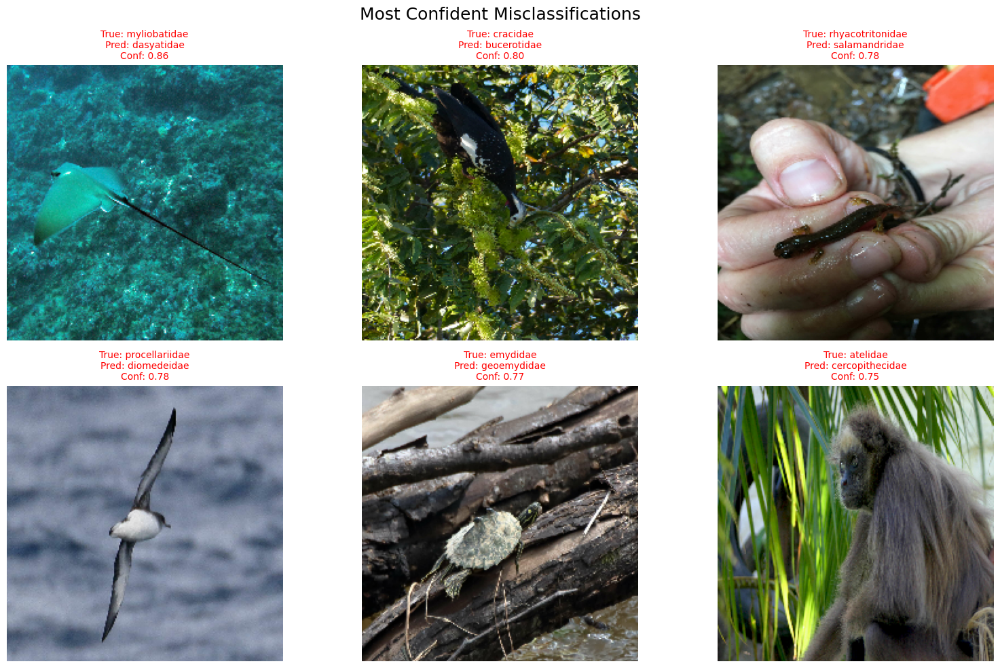

In [19]:
# Convert y_true to class labels
y_true_labels = np.argmax(y_true, axis=1)

# Get misclassified indices
misclassified_indices = np.where(y_true_labels != y_pred)[0]

# For each misclassified, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[misclassified_indices], axis=1)

# Sort misclassified examples by descending confidence
sorted_indices = np.argsort(confidences)[::-1]  # Sort descending
selected_indices = misclassified_indices[sorted_indices[:6]]  # Take top 6

# Prepare images to show (selected misclassified ones)
images_to_show = []

for idx in selected_indices:
    img = test_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(misclassified_indices == idx)][0]  # Get confidence for the current misclassified image
    images_to_show.append((img, true_label, pred_label, confidence))

# Save the misclassified data
misclassified_data = {
    "True Label": [class_names[true_label] for _, true_label, _, _ in images_to_show],
    "Predicted Label": [class_names[pred_label] for _, _, pred_label, _ in images_to_show],
    "Confidence": [confidence for _, _, _, confidence in images_to_show]
}

# Plot
plt.figure(figsize=(16, 10))

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(2, 3, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"True: {class_names[true_label]}\nPred: {class_names[pred_label]}\nConf: {confidence:.2f}", 
              color='red', fontsize=10)

plt.suptitle("Most Confident Misclassifications", fontsize=18)
plt.tight_layout()
plt.show()

In [20]:
misclassified_data

{'True Label': ['myliobatidae',
  'cracidae',
  'rhyacotritonidae',
  'procellariidae',
  'emydidae',
  'atelidae'],
 'Predicted Label': ['dasyatidae',
  'bucerotidae',
  'salamandridae',
  'diomedeidae',
  'geoemydidae',
  'cercopithecidae'],
 'Confidence': [0.8568413,
  0.7975312,
  0.7807963,
  0.77579063,
  0.76992434,
  0.75449306]}

#### Top Correctly Classified

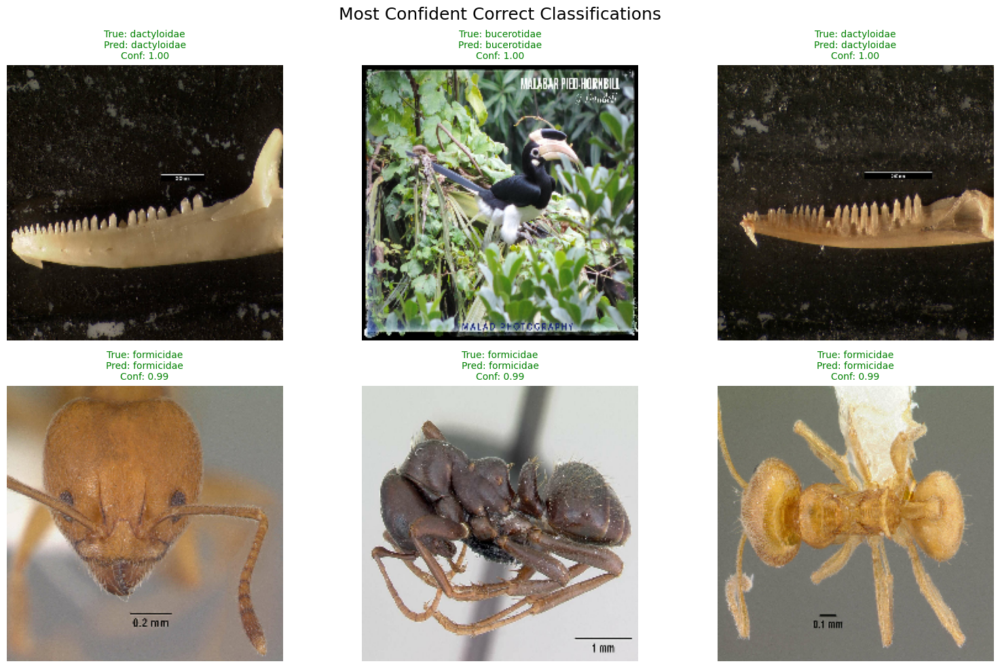

In [21]:
# Convert y_true to class labels
y_true_labels = np.argmax(y_true, axis=1)

# Get indices of correctly classified images
correct_indices = np.where(y_true_labels == y_pred)[0]

# For each correctly classified image, get model confidence (highest softmax probability)
confidences = np.max(pred_probs_all[correct_indices], axis=1)

# Sort correctly classified examples by descending confidence
sorted_indices = np.argsort(confidences)[::-1]  # Sort descending
selected_indices = correct_indices[sorted_indices[:6]]  # Take top 6 with highest confidence

# Prepare images to show (selected correctly classified ones)
images_to_show = []

for idx in selected_indices:
    img = test_images[idx]
    true_label = y_true_labels[idx]
    pred_label = y_pred[idx]
    confidence = confidences[np.where(correct_indices == idx)][0]  # Get confidence for the current correctly classified image
    images_to_show.append((img, true_label, pred_label, confidence))

# Save the misclassified data
correctly_classified_data = {
    "True Label": [class_names[true_label] for _, true_label, _, _ in images_to_show],
    "Predicted Label": [class_names[pred_label] for _, _, pred_label, _ in images_to_show],
    "Confidence": [confidence for _, _, _, confidence in images_to_show]
}

# Plot
plt.figure(figsize=(16, 10))

for i, (img, true_label, pred_label, confidence) in enumerate(images_to_show):
    plt.subplot(2, 3, i + 1)
    plt.imshow(img.astype("uint8"))
    plt.axis('off')
    plt.title(f"True: {class_names[true_label]}\nPred: {class_names[pred_label]}\nConf: {confidence:.2f}", 
              color='green', fontsize=10)

plt.suptitle("Most Confident Correct Classifications", fontsize=18)
plt.tight_layout()
plt.show()

In [22]:
correctly_classified_data

{'True Label': ['dactyloidae',
  'bucerotidae',
  'dactyloidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Predicted Label': ['dactyloidae',
  'bucerotidae',
  'dactyloidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Confidence': [0.9977162,
  0.9953852,
  0.9951009,
  0.99467677,
  0.99462795,
  0.99330115]}

#### Correctly Classified for Specific Class

In [23]:
misclassified_data

{'True Label': ['myliobatidae',
  'cracidae',
  'rhyacotritonidae',
  'procellariidae',
  'emydidae',
  'atelidae'],
 'Predicted Label': ['dasyatidae',
  'bucerotidae',
  'salamandridae',
  'diomedeidae',
  'geoemydidae',
  'cercopithecidae'],
 'Confidence': [0.8568413,
  0.7975312,
  0.7807963,
  0.77579063,
  0.76992434,
  0.75449306]}

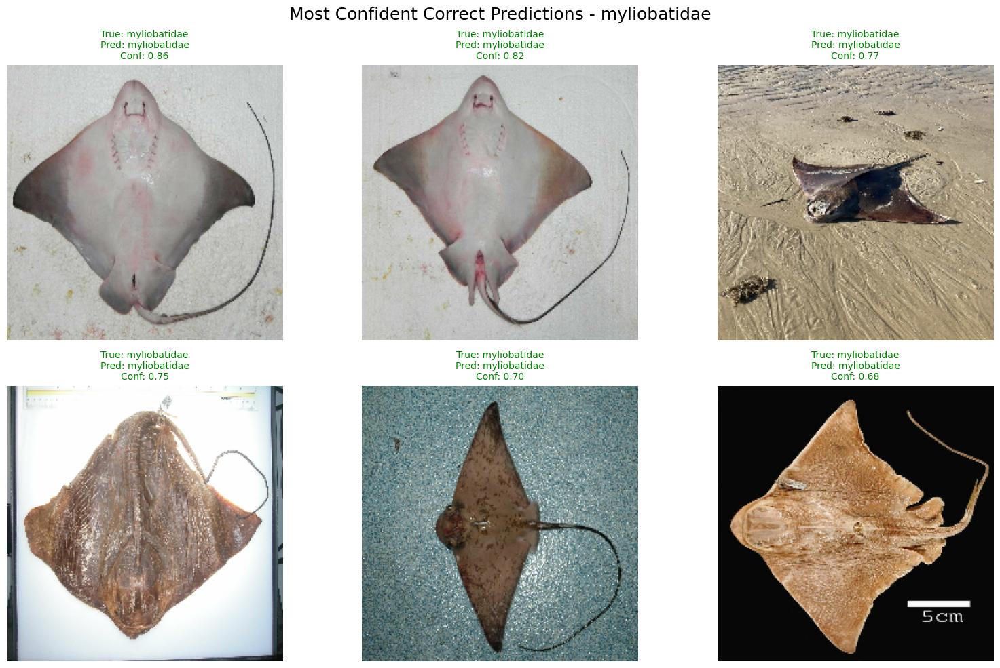

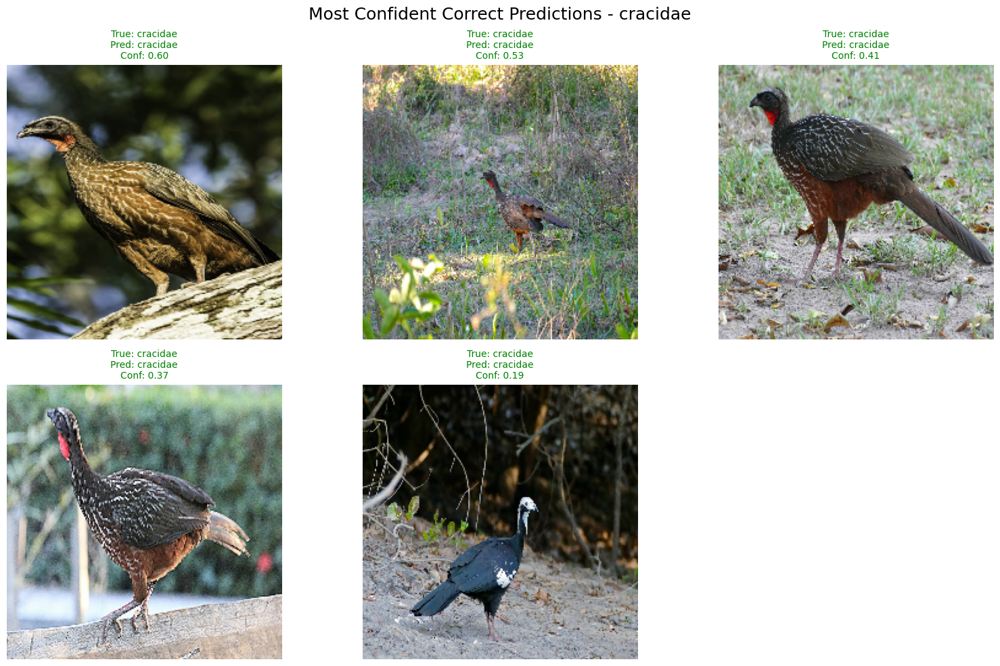

No correct predictions found for family 'rhyacotritonidae'.


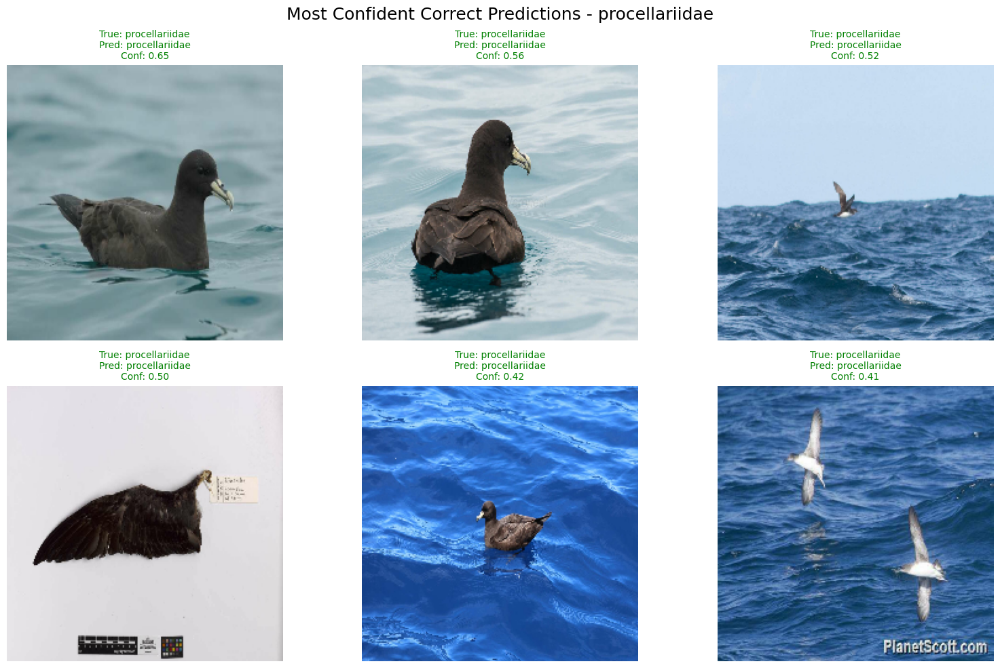

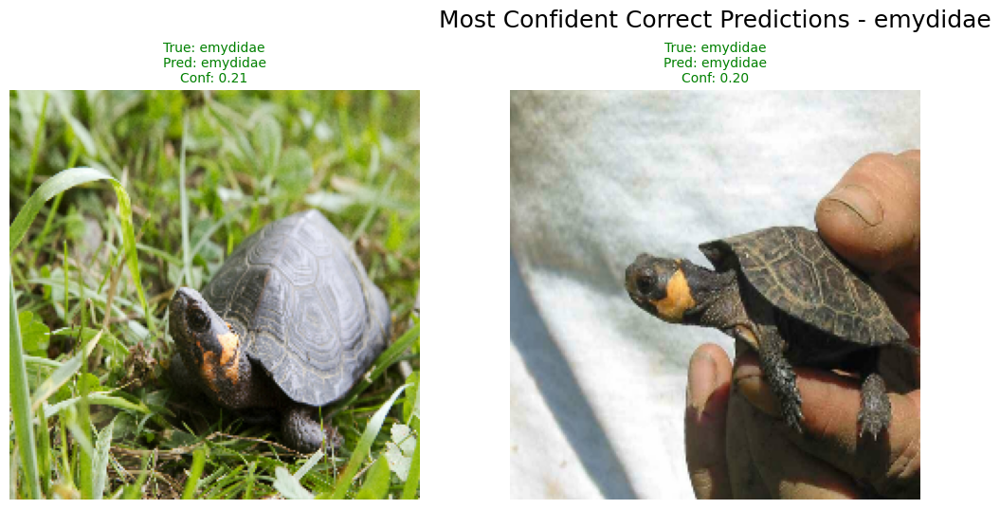

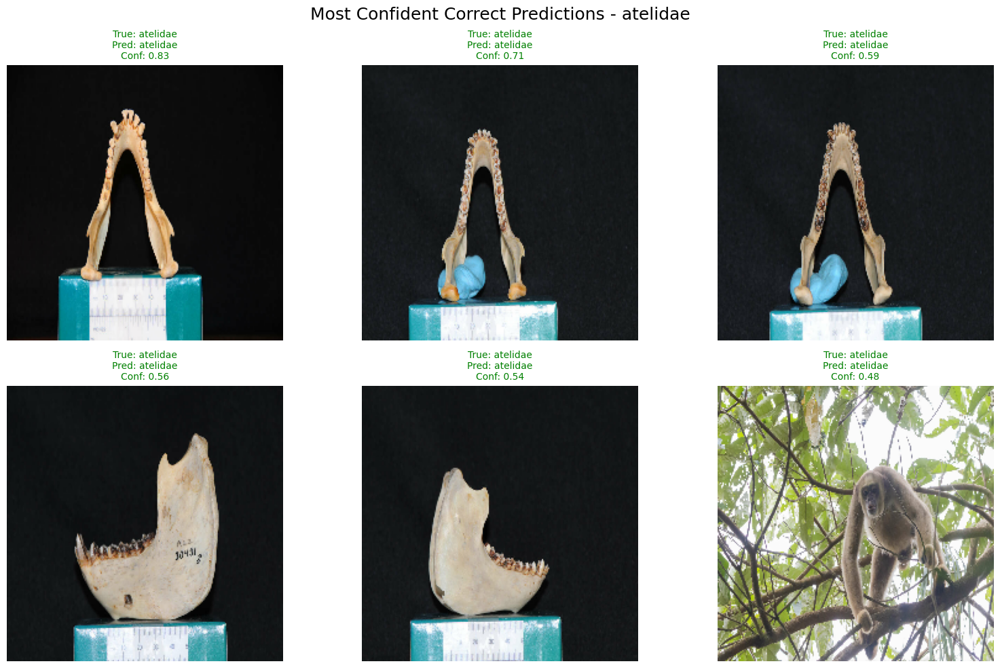

In [24]:
for family in misclassified_data["True Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)

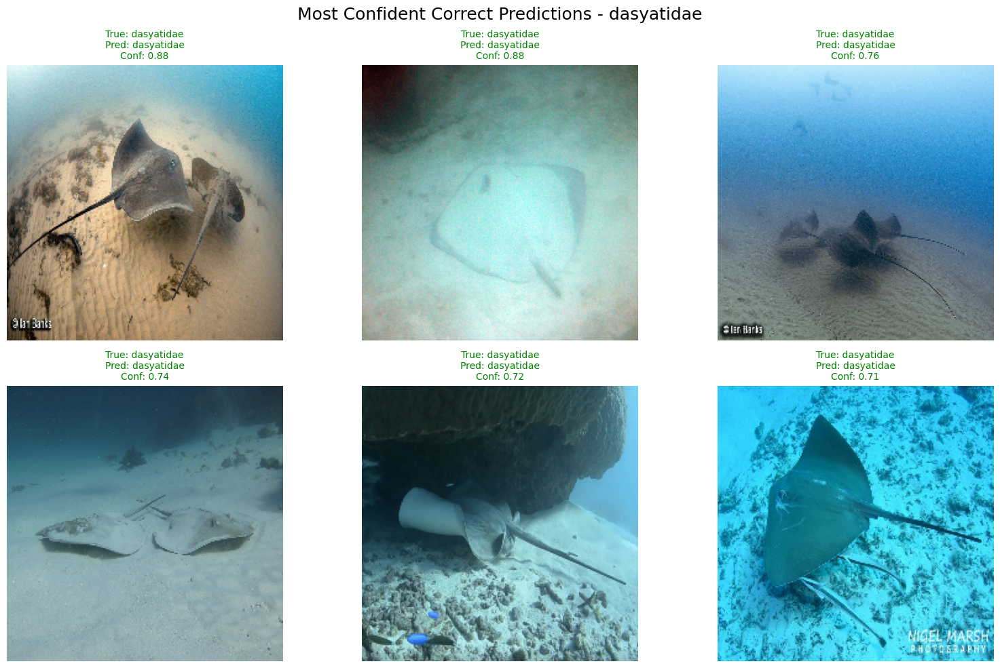

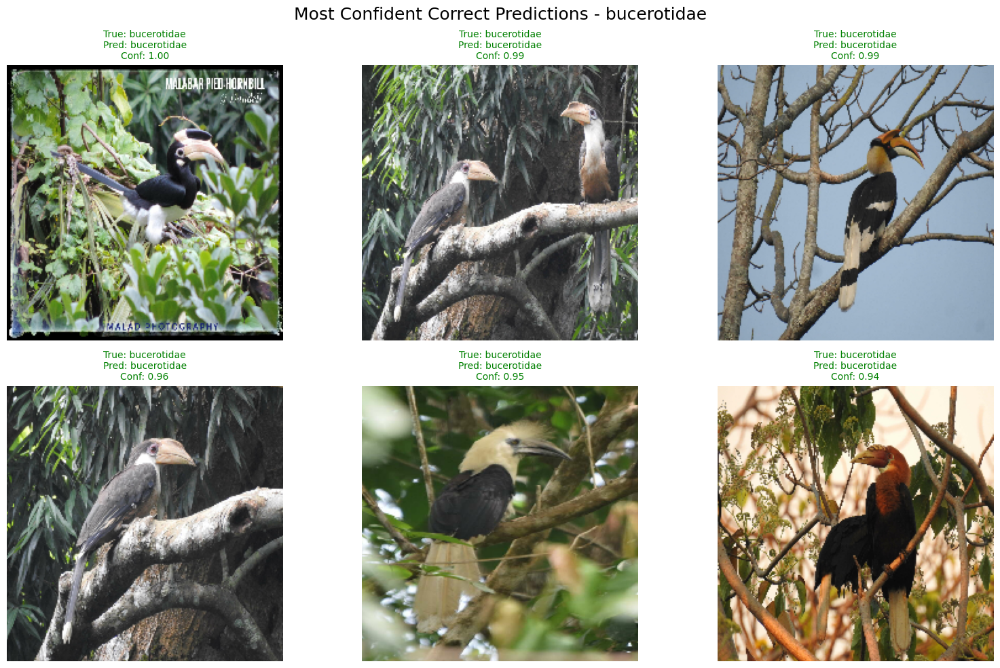

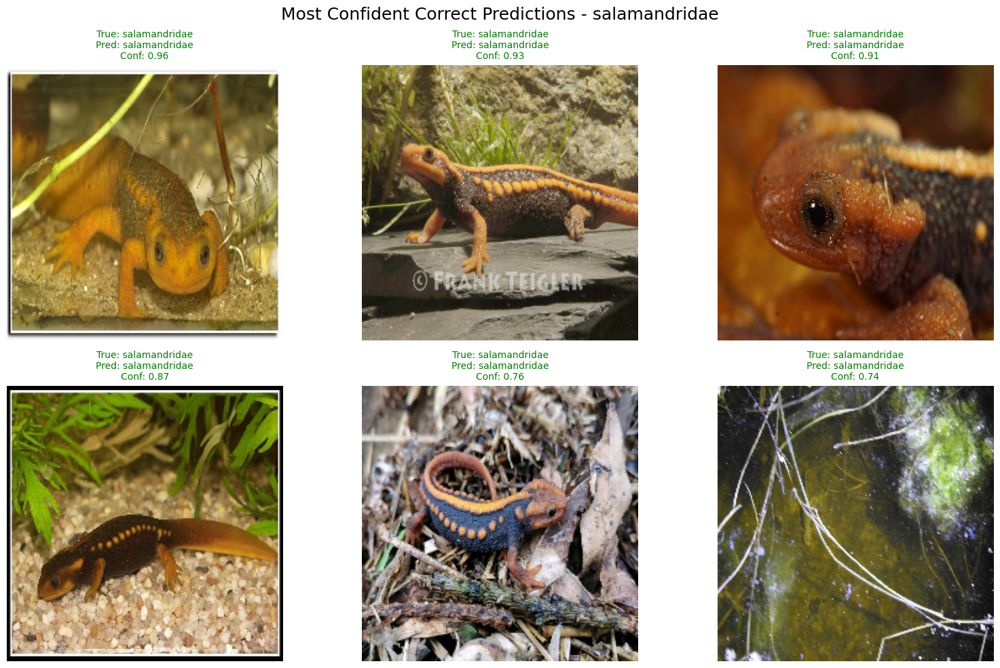

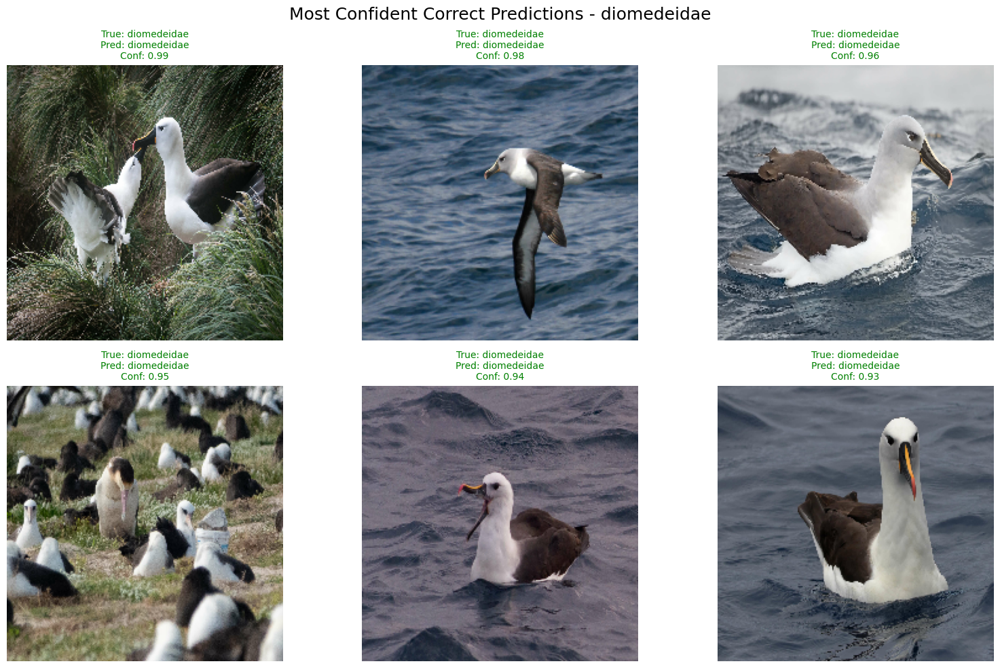

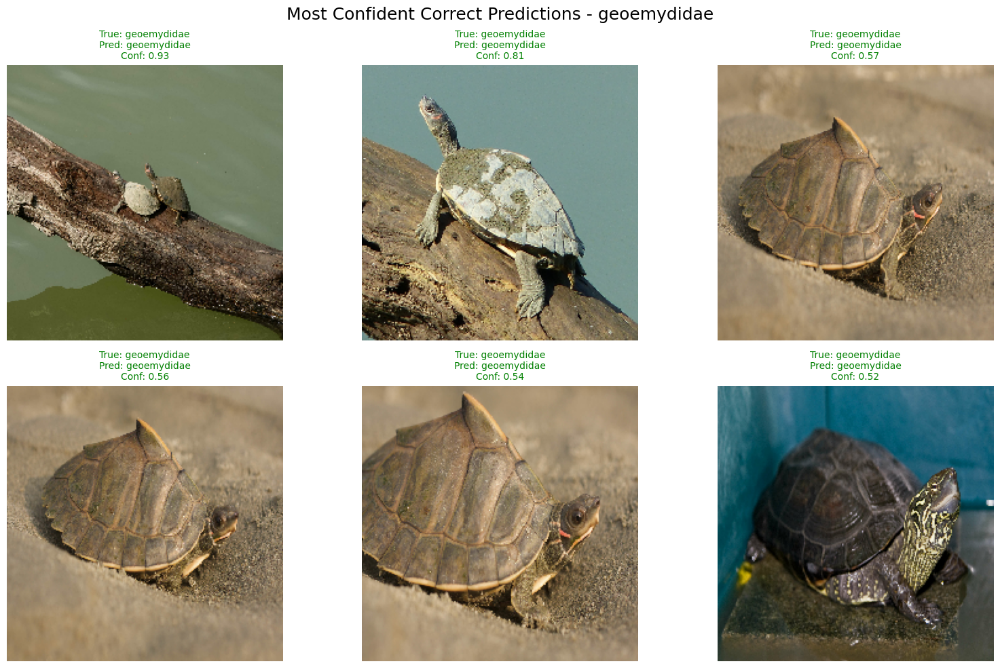

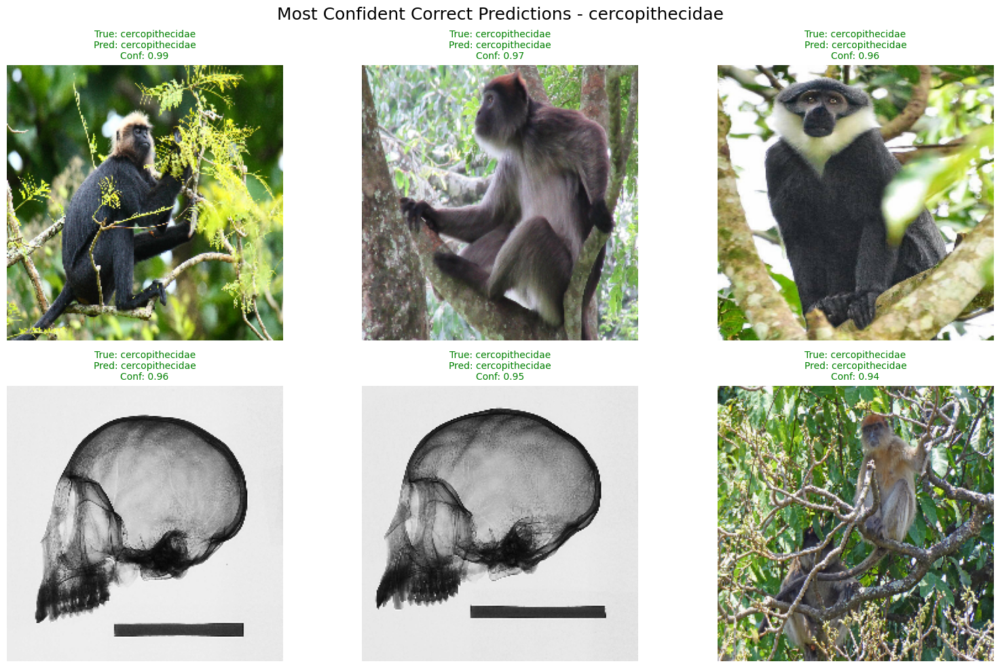

In [25]:
for family in misclassified_data["Predicted Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)

In [26]:
correctly_classified_data

{'True Label': ['dactyloidae',
  'bucerotidae',
  'dactyloidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Predicted Label': ['dactyloidae',
  'bucerotidae',
  'dactyloidae',
  'formicidae',
  'formicidae',
  'formicidae'],
 'Confidence': [0.9977162,
  0.9953852,
  0.9951009,
  0.99467677,
  0.99462795,
  0.99330115]}

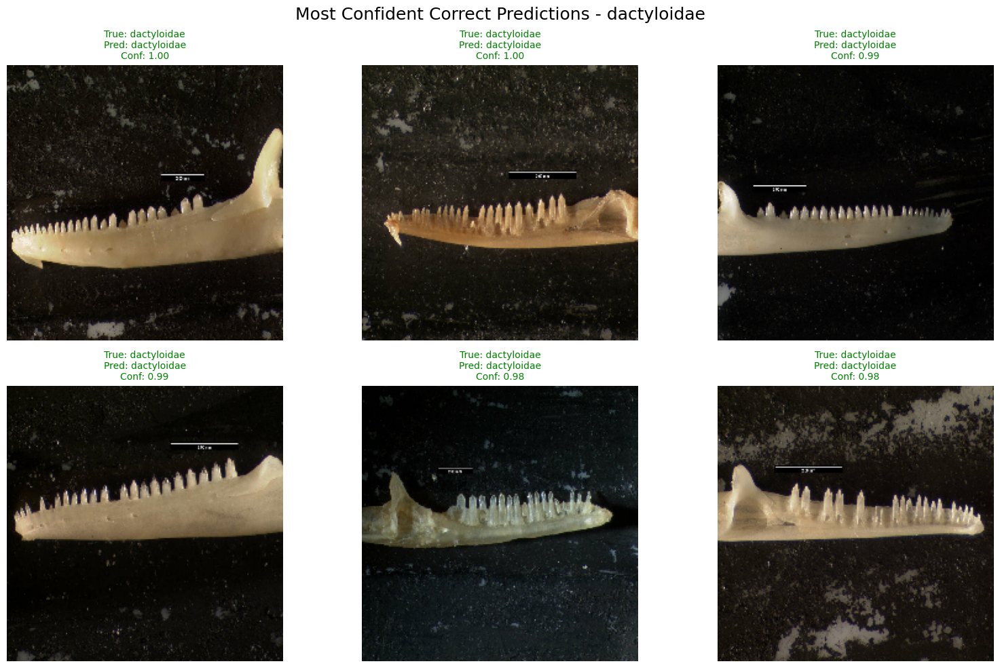

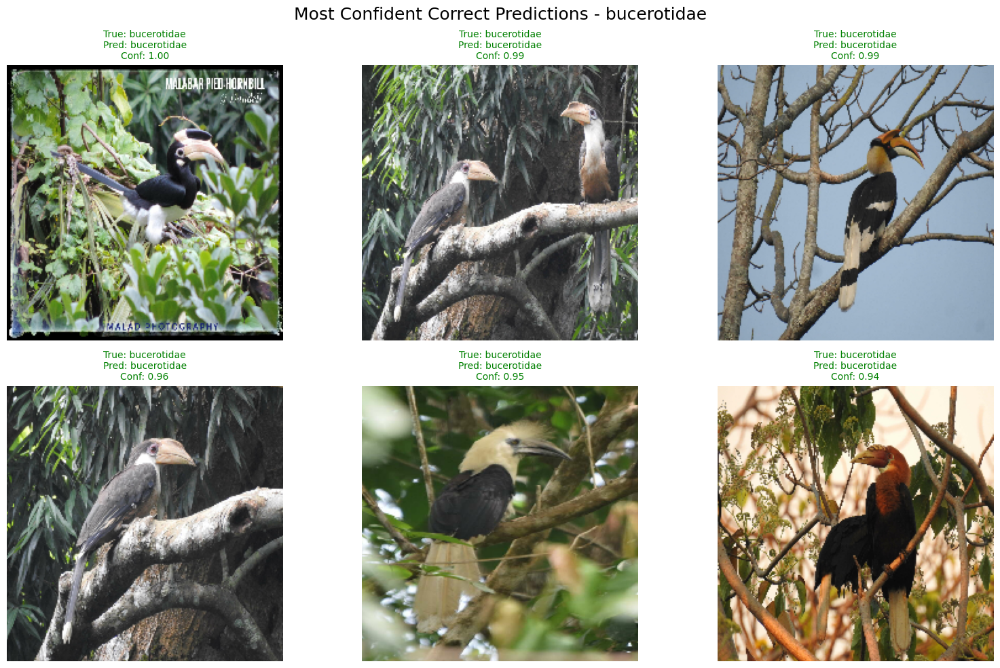

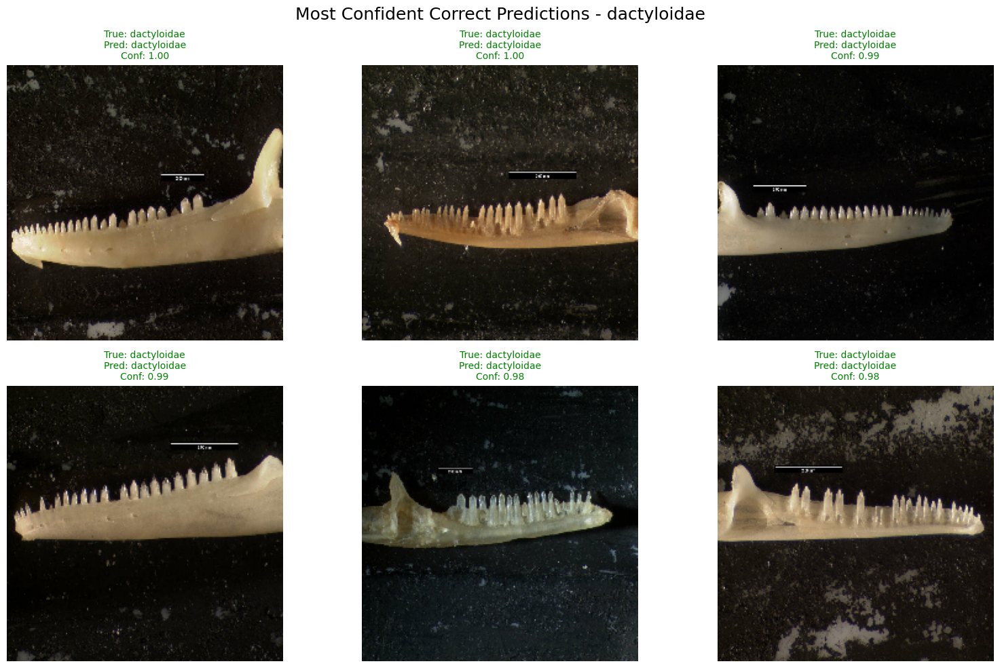

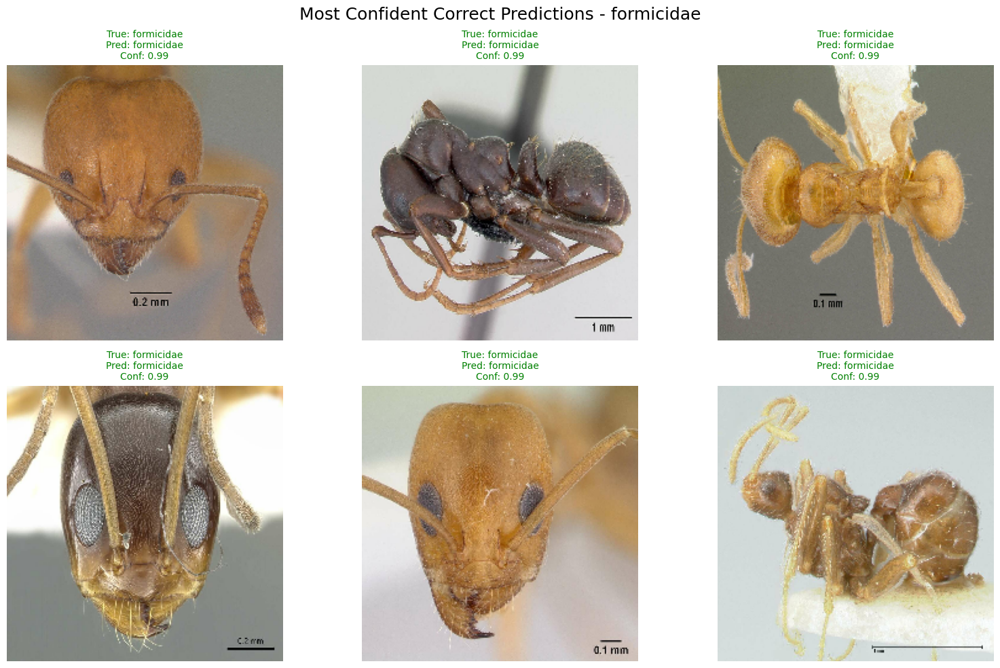

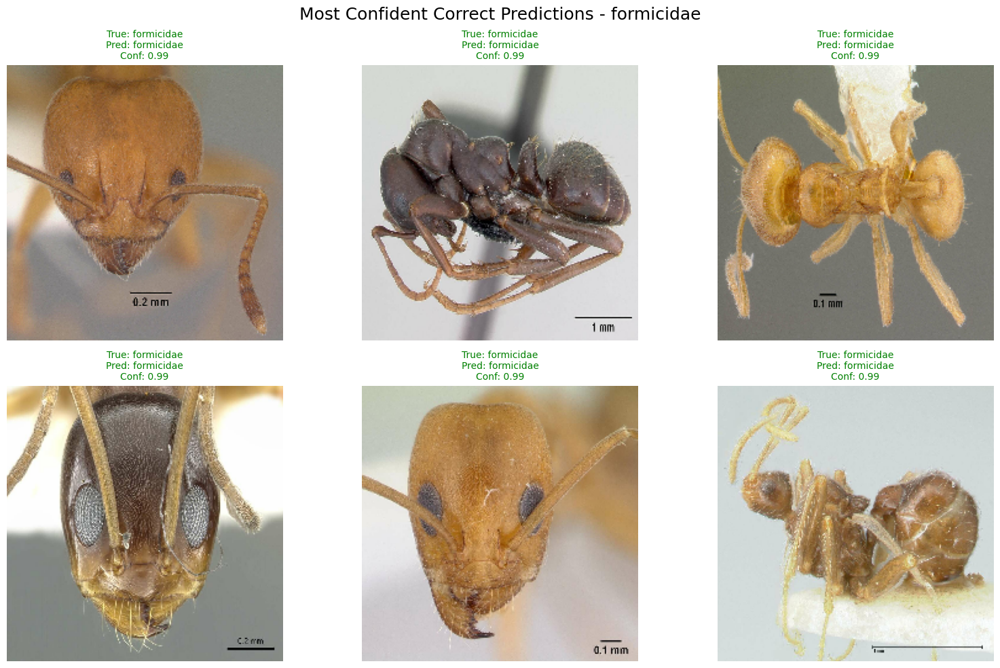

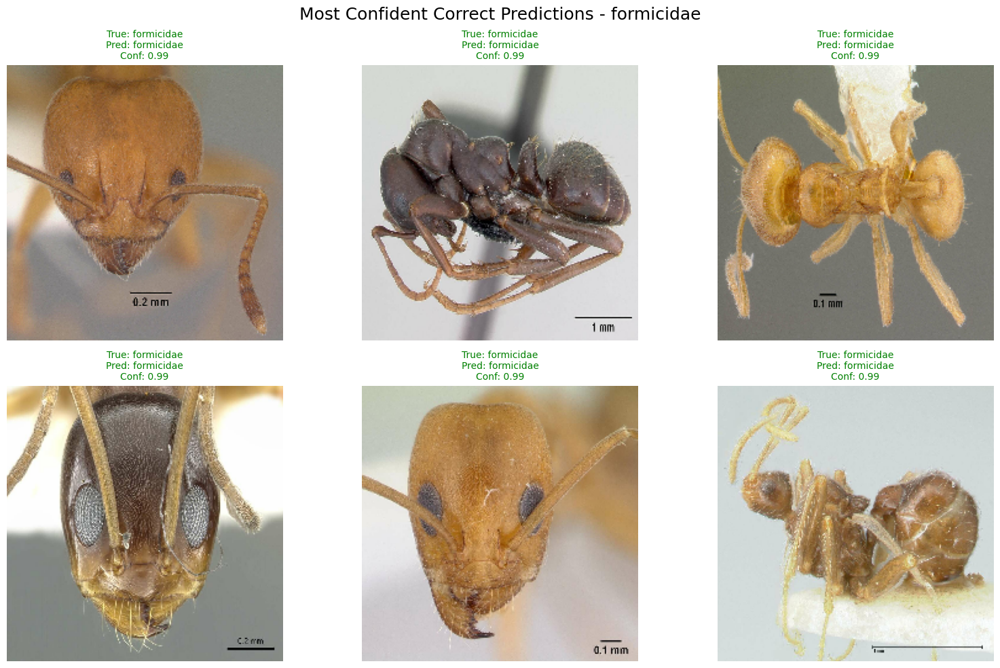

In [27]:
for family in correctly_classified_data["True Label"]:
    show_correct_predictions_for_family(y_true, y_pred, pred_probs_all, test_images, class_names, family_name=family, num_images=6)

<div class="alert alert-block alert-success">

# **4.** More

<div>

In [ ]:
import pandas as pd
import seaborn as sns
import os
import matplotlib.pyplot as plt


In [ ]:
files = {
    "VGG16": "vgg_history_train_until_opt.csv",
    "ResNet50": "resnet50_final_train_history.csv",
    "EfficientNet Baseline 1": "efficient_net_baseline1_history.csv",
    "EfficientNet Baseline 2": "efficient_net_baseline2_history.csv",
    "EfficientNet Final": "efficient_net_final_train_history.csv",
    "EfficientNet Fine-Tuned": "efficient_net_final_finetune_history.csv"
}


In [ ]:
def load_history(path):
    df = pd.read_csv(path)
    if 'acc' in df.columns:
        df = df.rename(columns={'acc': 'accuracy'})
    if 'val_acc' in df.columns:
        df = df.rename(columns={'val_acc': 'val_accuracy'})
    return df


In [ ]:
histories = {label: load_history(path) for label, path in files.items()}

summary_list = []
for label, df in histories.items():
    last_epoch = df.iloc[-1]
    # Para cada métrica, tenta pegar 'accuracy' e 'f1_score'
    summary_list.append({
        "Model": label,
        "Train Set Accuracy": last_epoch.get("accuracy", last_epoch.get("accuracy", None)),
        "Validation Set Accuracy": last_epoch.get("val_accuracy", last_epoch.get("val_accuracy", None)),
        "Train Set F1-Score": last_epoch.get("f1_score", last_epoch.get("f1_score", None)),
        "Validation Set F1-Score": last_epoch.get("val_f1_score", last_epoch.get("val_f1_score", None)),
        "Train Set Loss": last_epoch.get("loss", last_epoch.get("loss", None)),
        "Validation Set Loss": last_epoch.get("val_loss", last_epoch.get("val_loss", None))
    })

summary_df = pd.DataFrame(summary_list)
summary_df = summary_df.set_index("Model")
summary_df = summary_df.sort_values(by="Validation Set F1-Score", ascending=False)


### Final Summary

In [ ]:
summary_df = summary_df.sort_values(by="Validation Set F1-Score", ascending=False)

In [ ]:
summary_df

### Plots

In [ ]:
plt.rcParams['font.family'] = 'Aptos'

In [ ]:
sns.set_style("white")
plt.figure(figsize=(8, 10))
ax = summary_df[['Train Set Accuracy', 'Validation Set Accuracy']].plot(kind='bar', color=['navy', 'maroon'], legend=False)
ax.legend(loc='upper right', fontsize=10)
plt.ylabel("Score")
plt.ylim(0, 1)
plt.xticks(rotation=90)
plt.show()


In [ ]:
sns.set_style("white")
plt.figure(figsize=(8, 10))
ax = summary_df[['Train Set Loss', 'Validation Set Loss']].plot(kind='bar', color=['navy', 'maroon'], legend=False)
ax.legend(loc='upper left', fontsize=10)
plt.ylabel("Loss")
plt.ylim(0, 2.5)
plt.xticks(rotation=90)
plt.show()

In [ ]:
sns.set_style("white")
plt.figure(figsize=(8, 10))
ax = summary_df[['Train Set F1-Score', 'Validation Set F1-Score']].plot(kind='bar', color=['navy', 'maroon'], legend=False)
ax.legend(loc='upper right', fontsize=10)
plt.ylabel("F1-Score")
plt.ylim(0, 1)
plt.xticks(rotation=90)
plt.show()

### Test Performance

In [ ]:
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input

In [ ]:
test_ds, _ = preprocess.load_img(
    data_dir="../data/rare_species/test",
    minority_class=[],
    augment=None,
    shuffle= False,
    preprocessing_function=preprocess_input)

In [ ]:
get_metric(test_ds, "efficient_net_finetuned_final.keras")